# Chest X-ray Görüntü Ön İşleme Proje Özeti ve Aşamaları

Bu projede, [ChestX-ray8 dataset](https://arxiv.org/abs/1705.02315) veri seti kullanılarak göğüs röntgeni görüntüleri üzerinde veri keşfi ve görüntü işleme teknikleri uygulanacaktır.

<img src="https://raw.githubusercontent.com/hardik0/AI-for-Medicine-Specialization/master/AI-for-Medical-Diagnosis/Week-1/xray-image.png" alt="U-net Image" width="300" align="middle"/>

## Proje Aşamaları

### 1. Veri Yükleme
#### 1.1 Kütüphanelerin İçe Aktarılması
* Pandas, Numpy, Matplotlib ve Seaborn gibi kütüphaneler içe aktarılacak.
* `os` modülü kullanılarak dosya yolları belirtilecek.

#### 1.2 Veri Setinin Yüklenmesi
* `train_df` olarak adlandırılan veri çerçevesine veri seti yüklenecek.
* İlk birkaç satır incelenecek ve toplam satır/sütun sayısı ekrana yazdırılacak.

#### 1.3 Veri Özelliklerinin İncelenmesi
* Sütunlardaki veri türleri ve eksik değerler analiz edilecek.
* `PatientId` sütunundaki benzersiz hasta sayısı hesaplanacak.
* Hastaların birden fazla görüntüsünün olup olmadığı kontrol edilecek.

### 2. Görüntü Yükleme ve Görselleştirme
#### 2.1 Rastgele Görüntüler Seçme
* `train_df`'in "Image" sütunundan rastgele 9 görüntü seçilecek.
* Görseller yan yana görselleştirilecek.

#### 2.2 Rastgele Görüntülerin İstatistiksel Özelliklerini Hesaplama
* Her bi görüntü için Maksimum, minimum, ortalama ve standart sapma değerleri hesaplanacak.

#### 2.3 Histogram Çizimi
* Görseller için piksel yoğunluk histogramları oluşturulacak.

### 3. Görüntü İşleme ve İyileştirme
#### 3.1 Kontrast Germe
* Minimum ve maksimum piksel değerlerine göre kontrast germe yapılacak.

#### 3.2 Histogram Eşitleme
* Kontrast germe sonrası histogram eşitleme uygulanacak.

#### 3.3 Gamma Düzeltme
* Görüntünün parlaklığı gamma düzeltme ile ayarlanacak.

### 4. Gürültü Azaltma
#### 4.1 Median ve Gaussian Blur Uygulama
* Gamma düzeltme sonrası median ve gaussian blur uygulanacak ve sonuçları karşılaştırılacak.

### 5. Döndürme ve Ayna Çevirme
#### 5.1 Rastgele Açılarla Döndürme
* Görüntü 0-10 derece arasında rastgele bir açıda döndürülecek.

#### 5.2 Ayna Çevirme
* Görüntü yatay olarak çevrilecek ve sonuç görselleştirilecek.

### 6. Frekans Alanında Filtreleme
#### 6.1 Fourier Dönüşümü ve Filtreleme
* Görüntü frekans alanına dönüştürülecek, düşük frekansları geçiren maske uygulanacak. Ardından ters Fourier dönüşümü ile frekans alanında filtreleme yapılacak.

### 7. Keskinleştirme ve Enterpolasyon
### 7.1 Keskinleştirme
* `Unsharp masking` tekniği ile görüntü keskinleştirilecek.

### 7.2 Bicubic Enterpolasyon
* Görüntü iki kat büyütülerek enterpolasyon yapılacak.


# 1. Veri Yükleme

## 1.1 Kütüphanelerin İçe Aktarılması
* Veri işleme, sayısal işlemler ve veri görselleştirme operasyonlarında kullanılmak üzere Pandas, Numpy, Matplotlib ve Seaborn gibi kütüphaneler içe aktarılacak.
* `os` modülü kullanılarak dosya yolları belirtilecek.

In [ ]:
import pandas as pd
import numpy as np
import matplotlib.pyplot as plt
from scipy.ndimage import zoom
from scipy.ndimage import rotate
from skimage.transform import rotate
import cv2
import random
%matplotlib inline
import os
import seaborn as sns
sns.set()

In [ ]:
!git clone https://github.com/hardik0/AI-for-Medicine-Specialization
%cd AI-for-Medicine-Specialization/AI-for-Medical-Diagnosis/

fatal: destination path 'AI-for-Medicine-Specialization' already exists and is not an empty directory.
/content/AI-for-Medicine-Specialization/AI-for-Medical-Diagnosis


In [ ]:
%ls nih/

densenet.hdf5  images_small/  pretrained_model.h5  test.csv  train-small.csv  valid-small.csv


## 1.2 Veri Setinin Yüklenmesi
* `train_df` olarak adlandırılan veri çerçevesine veri seti yüklenecek.
* İlk birkaç satır incelenecek ve toplam satır/sütun sayısı ekrana yazdırılacak.

In [ ]:
# Veri setinin yüklenmesi
train_df = pd.read_csv("nih/train-small.csv")
# Veri setinin boyutlarının bilgisinin verilmesi ve ilk birkaç satırın kontrol edilmesi
print(f'There are {train_df.shape[0]} rows and {train_df.shape[1]} columns in this data frame\n')
train_df.head()

There are 1000 rows and 16 columns in this data frame



,Image,Atelectasis,Cardiomegaly,Consolidation,Edema,Effusion,Emphysema,Fibrosis,Hernia,Infiltration,Mass,Nodule,PatientId,Pleural_Thickening,Pneumonia,Pneumothorax
0,00008270_015.png,0,0,0,0,0,0,0,0,0,0,0,8270,0,0,0
1,00029855_001.png,1,0,0,0,1,0,0,0,1,0,0,29855,0,0,0
2,00001297_000.png,0,0,0,0,0,0,0,0,0,0,0,1297,1,0,0
3,00012359_002.png,0,0,0,0,0,0,0,0,0,0,0,12359,0,0,0
4,00017951_001.png,0,0,0,0,0,0,0,0,1,0,0,17951,0,0,0


## 1.3 Veri Özelliklerinin İncelenmesi
* Sütunlardaki veri türleri ve eksik değerler analiz edilecek.
* `PatientId` sütunundaki benzersiz hasta sayısı hesaplanacak.
* Hastaların birden fazla görüntüsünün olup olmadığı kontrol edilecek.

In [ ]:
# Veri Türlerinin ve Eksik Değerlerin Analizi
train_df.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 1000 entries, 0 to 999
Data columns (total 16 columns):
 #   Column              Non-Null Count  Dtype 
---  ------              --------------  ----- 
 0   Image               1000 non-null   object
 1   Atelectasis         1000 non-null   int64 
 2   Cardiomegaly        1000 non-null   int64 
 3   Consolidation       1000 non-null   int64 
 4   Edema               1000 non-null   int64 
 5   Effusion            1000 non-null   int64 
 6   Emphysema           1000 non-null   int64 
 7   Fibrosis            1000 non-null   int64 
 8   Hernia              1000 non-null   int64 
 9   Infiltration        1000 non-null   int64 
 10  Mass                1000 non-null   int64 
 11  Nodule              1000 non-null   int64 
 12  PatientId           1000 non-null   int64 
 13  Pleural_Thickening  1000 non-null   int64 
 14  Pneumonia           1000 non-null   int64 
 15  Pneumothorax        1000 non-null   int64 
dtypes: int64(15), object(1)
m

Yukarıda görüldüğü üzere 16 değişkenin 15 tanesi integer veri tipinde sayısal bilgi içermektedir.
1000 gözlem birimine sahip veri setimizin hiçbir değişkeninde eksik değer bulunmamaktadır.
`PatientId` ise hastaların tekil kodunu belirten id'leri içeren kolondur. Şimdi her bir hastanın gözlem birimi sayısını inceleyelim.

In [ ]:
# Tüm hasta kimliklerinin toplam sayısının ve bunların kaçının benzersiz olduğunun ekrana yazdırılması
print(f"Toplam hasta kimliklerinin sayısı {train_df['PatientId'].count()}, bu hastalardan benzersiz (Tekil) gözlem birimine sahip olan kimlikler {train_df['PatientId'].value_counts().shape[0]} ")


Toplam hasta kimliklerinin sayısı 1000, bu hastalardan benzersiz (Tekil) gözlem birimine sahip olan kimlikler 928 


In [ ]:
# Her bir hastanın sahip olduğu görüntü sayısının hesaplanması
# Tekil olmayan her bir hastanın birden fazla görüntüsü olup olmadığını belirleme
patient_multiple_images = train_df['PatientId'].value_counts()
patients_with_multiple_images = patient_multiple_images[patient_multiple_images > 1]
patients_with_unique_images = patient_multiple_images[patient_multiple_images == 1]

print(f"Birden fazla görüntüye sahip hasta sayısı: {len(patients_with_multiple_images)} \n")
print(f"Tekil görüntüye sahip hasta sayısı: {len(patients_with_unique_images)}")


Birden fazla görüntüye sahip hasta sayısı: 59 

Tekil görüntüye sahip hasta sayısı: 869


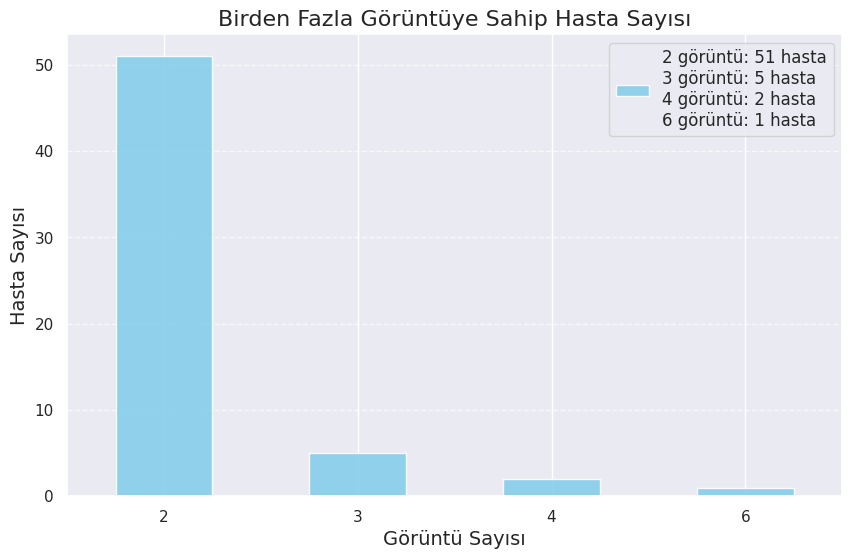

In [ ]:
# Görselleştirme için her görüntü sayısının kaç hasta tarafından sahip olduğunun hesaplaması
patients_with_multiple_images_count = patients_with_multiple_images.value_counts()

# Değerlerin detayları
details = {key: patients_with_multiple_images_count.get(key, 0) for key in [2, 3, 4, 6]}

# Çubuk grafik oluşturma
plt.figure(figsize=(10, 6))
bars = patients_with_multiple_images_count.plot(kind='bar', color='skyblue', alpha=0.9)
plt.title("Birden Fazla Görüntüye Sahip Hasta Sayısı", fontsize=16)
plt.xlabel("Görüntü Sayısı", fontsize=14)
plt.ylabel("Hasta Sayısı", fontsize=14)
plt.xticks(rotation=0)
plt.grid(axis='y', linestyle='--', alpha=0.7)

# Legend ve açıklamaların eklenmesi
legend_text = '\n'.join([f"{key} görüntü: {value} hasta" for key, value in details.items()])
plt.legend([legend_text], loc='upper right', fontsize=12)

# Grafiği gösterme
plt.show()

Yukarıda yaptığımız analizlere göre 1000 gözlem birimlik veri setinde 869 hastanın birer görüntüsü varken, 59 hastanın birden fazla görüntüsü vardır. Bu 59 hasta içerisinde,
- 51 hastanın 2 görüntüsü
- 5 hastanın 3 görüntüsü
- 2 hastanın 4 görüntüsü
- 1 hastanın ise 6 görüntüsü bulunmaktadır.

In [ ]:
# Kolonların alınması
columns = train_df.keys()
columns = list(columns)
print("Tüm kolonlar:", columns)

# Hastalara ait görsel kodu içeren ve Hastaların kimliklerini belirten değişkenlerin çıkarılması
columns.remove('Image')
columns.remove('PatientId')

# Toplam sınıf sayısının ve sınıf isimlerinin yazdırılması
print(f"Bu veri setinde {len(columns)} etiket bulunmaktadır: {columns}")

# Her bir sınıf için pozitif etiket (1) sayısını yazdırma
print("\nHer bir sınıf için pozitif etiket sayıları:")
positive_label_counts = {column: train_df[column].sum() for column in columns}
for column, count in positive_label_counts.items():
    print(f"Sınıf {column} için {count} pozitif örnek bulunmaktadır.")


Tüm kolonlar: ['Image', 'Atelectasis', 'Cardiomegaly', 'Consolidation', 'Edema', 'Effusion', 'Emphysema', 'Fibrosis', 'Hernia', 'Infiltration', 'Mass', 'Nodule', 'PatientId', 'Pleural_Thickening', 'Pneumonia', 'Pneumothorax']
Bu veri setinde 14 etiket bulunmaktadır: ['Atelectasis', 'Cardiomegaly', 'Consolidation', 'Edema', 'Effusion', 'Emphysema', 'Fibrosis', 'Hernia', 'Infiltration', 'Mass', 'Nodule', 'Pleural_Thickening', 'Pneumonia', 'Pneumothorax']

Her bir sınıf için pozitif etiket sayıları:
Sınıf Atelectasis için 106 pozitif örnek bulunmaktadır.
Sınıf Cardiomegaly için 20 pozitif örnek bulunmaktadır.
Sınıf Consolidation için 33 pozitif örnek bulunmaktadır.
Sınıf Edema için 16 pozitif örnek bulunmaktadır.
Sınıf Effusion için 128 pozitif örnek bulunmaktadır.
Sınıf Emphysema için 13 pozitif örnek bulunmaktadır.
Sınıf Fibrosis için 14 pozitif örnek bulunmaktadır.
Sınıf Hernia için 2 pozitif örnek bulunmaktadır.
Sınıf Infiltration için 175 pozitif örnek bulunmaktadır.
Sınıf Mass için 

Son yaptığımız analize göre elde edilen bazı çıkarımlar:

* Dengesiz Dağılım: Bazı sınıflarda (ör. Hernia) çok az pozitif örnek varken, Infiltration gibi sınıflarda oldukça fazla pozitif örnek bulunmaktadır. Bu durum, dengesiz bir veri seti yapısına işaret etmektedir.
* Modelleme için Zorluklar: Özellikle Hernia, Pneumonia, ve Emphysema gibi sınıflar için veri sayısının azlığı, olası kurulacak bir modelin bu hastalıkları doğru bir şekilde öğrenmesini zorlaştırabilir.

# 2. Görüntü Yükleme ve Görselleştirme

## 2.1 Rastgele Görüntüler Seçme
* `train_df`'in "Image" sütunundan rastgele 9 görüntü seçilecek.
* Görseller yan yana görselleştirilecek.

Rastgele Görüntülerin Gösterimi



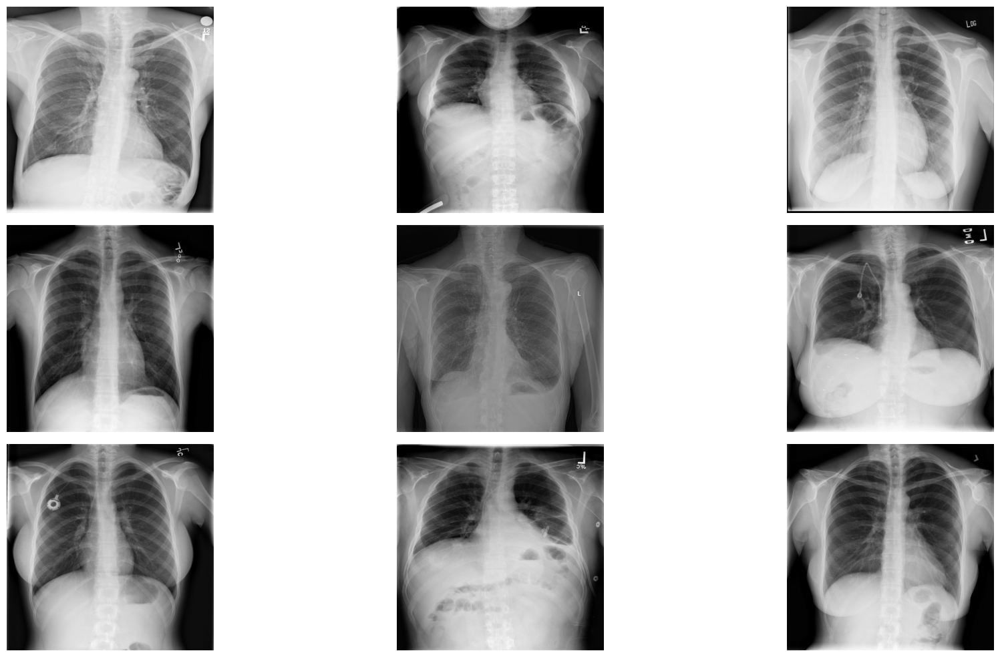

In [ ]:
# Veri setindeki Image sütununu kullanarak görsellerin isimlerinin elde edilmesi
images = train_df['Image'].values

# images sütunundan rastgele 9 görüntünün seçilmesi ve seçilen görüntülerin dosya adlarıyla bir liste oluşturulması
random_images = [np.random.choice(images) for i in range(9)]

# Görüntü dosyalarının bulunduğu dizinin konumu
img_dir = 'nih/images_small/'

print('Rastgele Görüntülerin Gösterimi\n')

# Görsellerin boyutlarını ayarlama
plt.figure(figsize=(20,10))

# Rastgele seçilen 9 görüntüyü döngü ile çizdirme
for i in range(9):
    # Alt grafiklerin (subplot) düzenlenmesi
    plt.subplot(3, 3, i + 1)

    # Görüntü dosyasını belirtilen dizinden okuma
    img = plt.imread(os.path.join(img_dir, random_images[i]))

    # Görüntüyü gri tonlamada gösterme
    plt.imshow(img, cmap='gray')

    # Görüntü etrafındaki eksenleri kaldırma
    plt.axis('off')

# Alt grafikler arasında belirtilen boşlukların bırakılması
plt.tight_layout()


## 2.2 Rastgele Görüntülerin İstatistiksel Özelliklerini Hesaplama
* Her bi görüntünün Maksimum, minimum, ortalama ve standart sapma değerlerinin hesaplanması

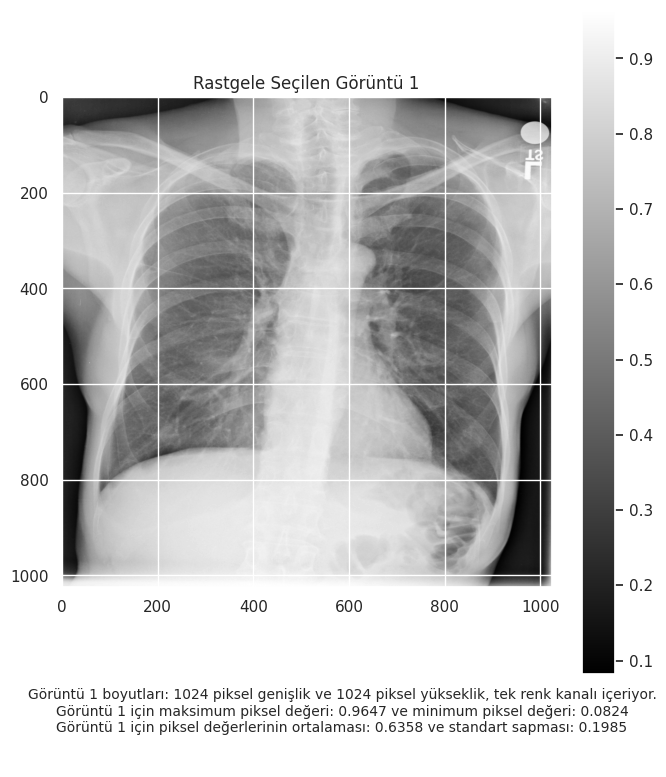

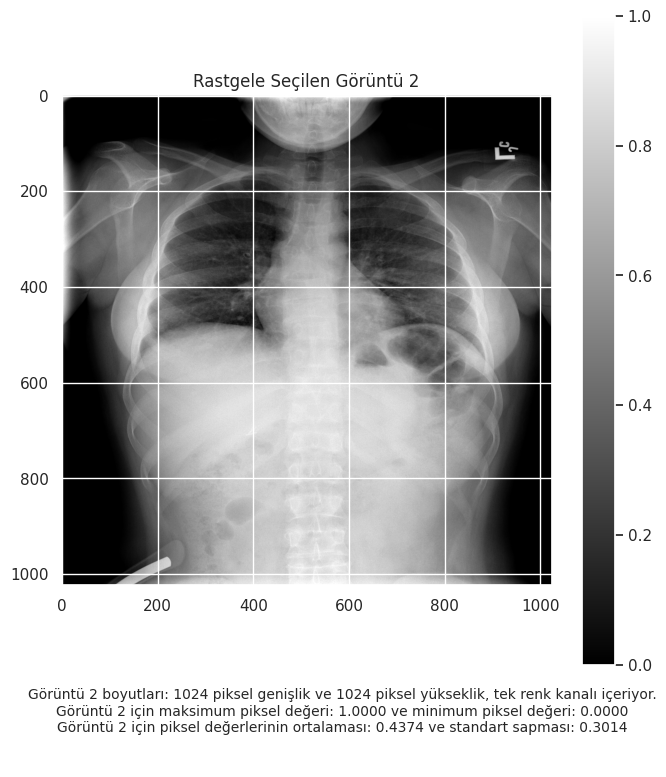

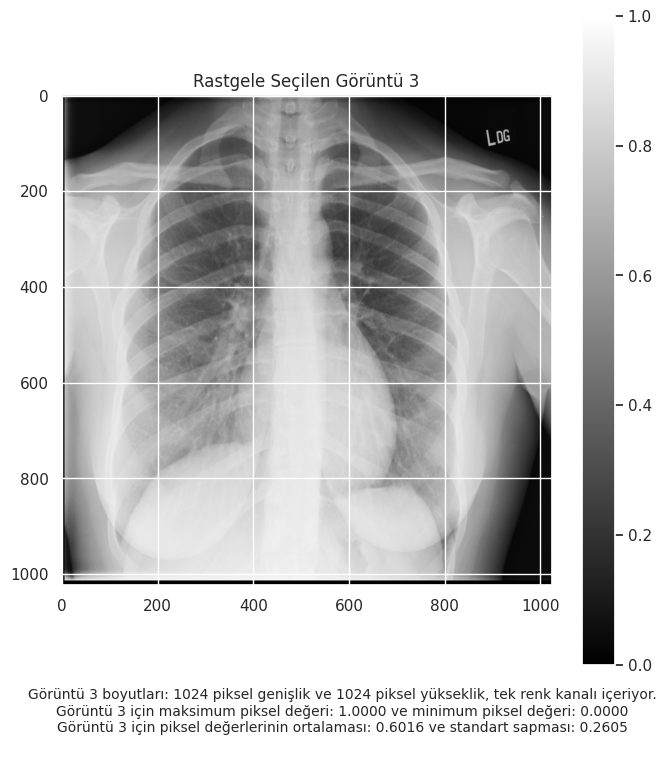

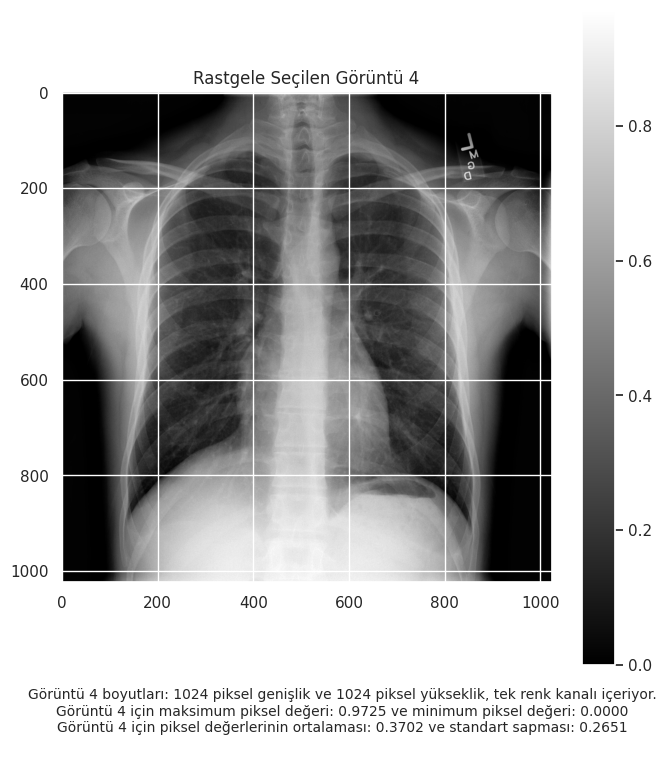

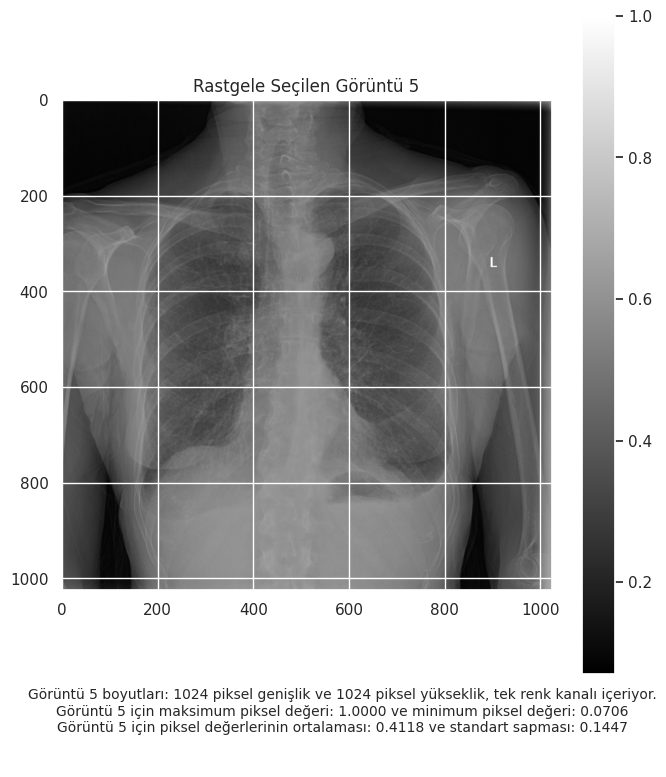

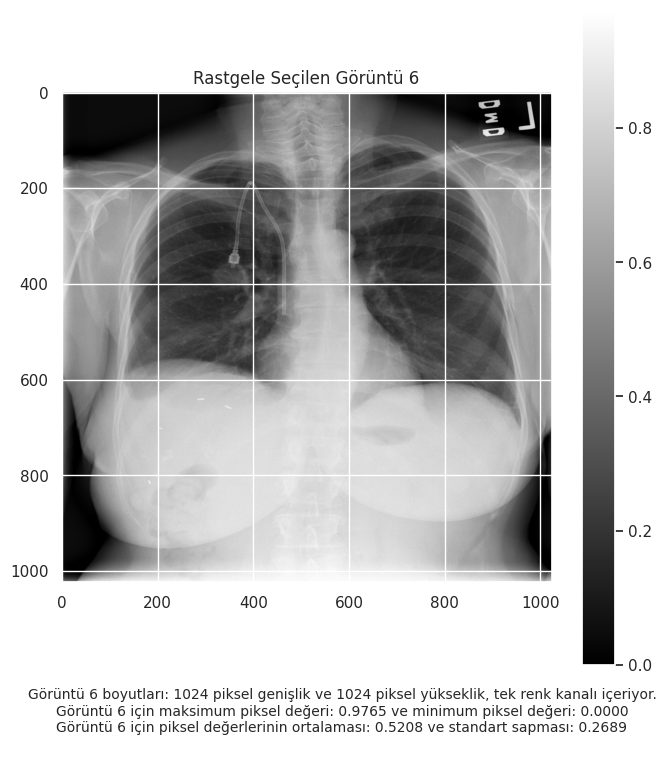

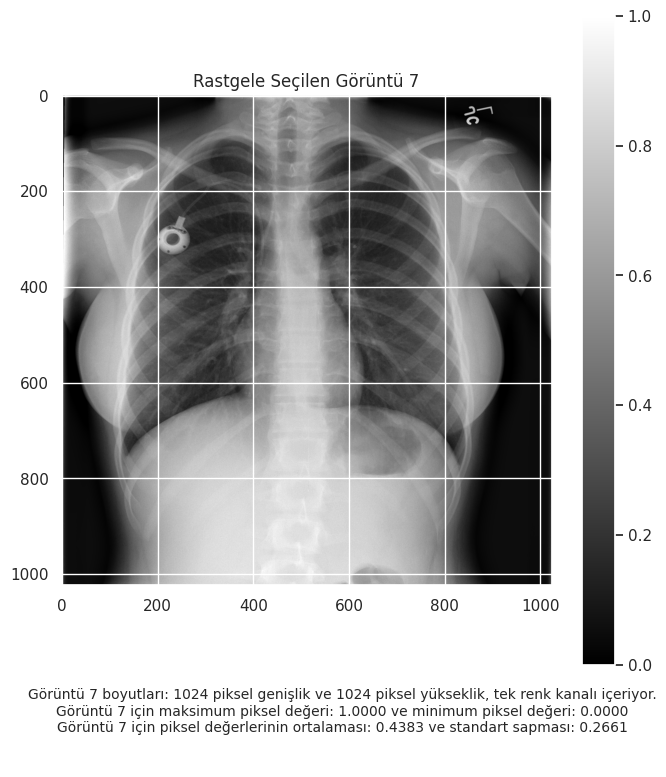

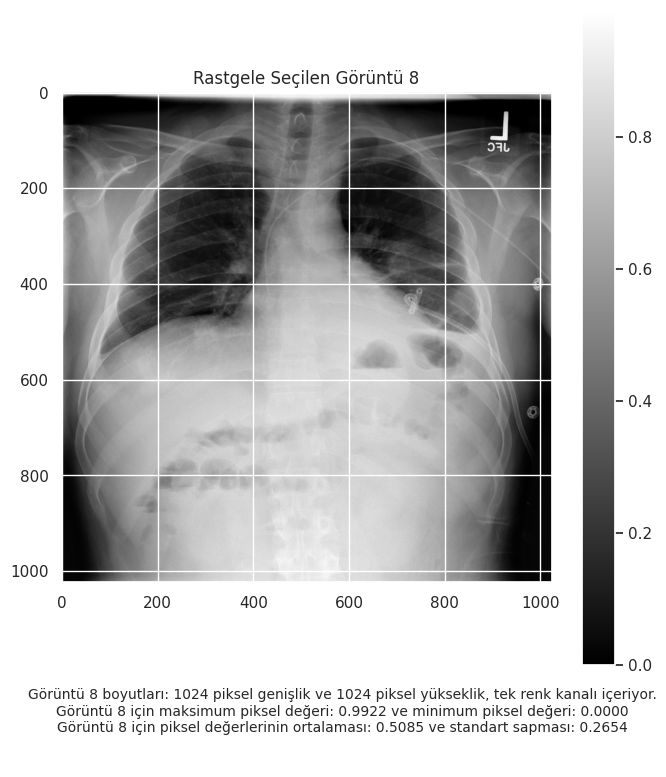

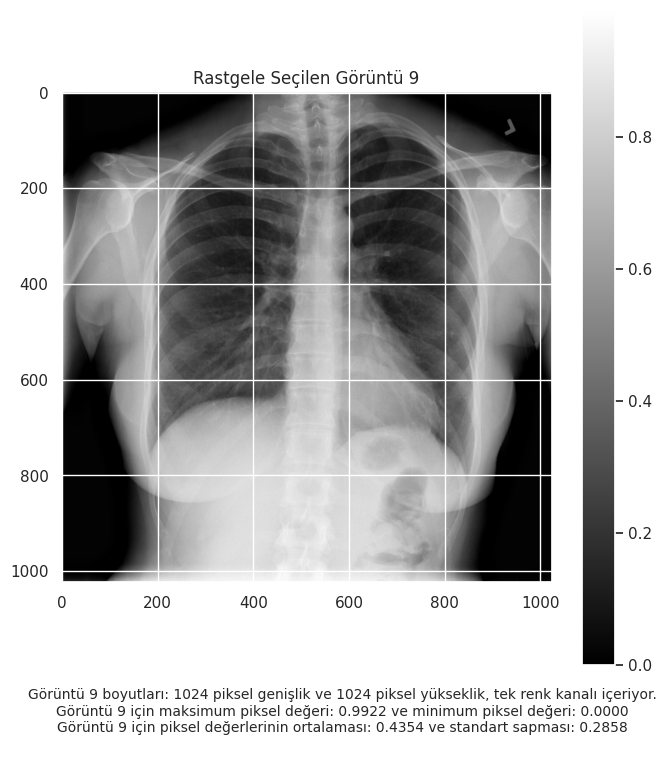

In [ ]:
# Her bir rastgele görüntü için analiz
for idx, image_name in enumerate(random_images):
    # Görüntü dosyasını yükleme
    img_path = os.path.join(img_dir, image_name)
    raw_image = plt.imread(img_path)

    # Yeni bir görselleştirme figürü oluşturma
    plt.figure(figsize=(7, 7))

    # Görüntüyü gri tonlamada görselleştirme
    plt.imshow(raw_image, cmap='gray')
    plt.colorbar()
    plt.title(f'Rastgele Seçilen Görüntü {idx+1}')
    ## plt.axis('off')  # Eksenleri kaldırma

    # Görselin altına analiz sonuçlarını yazdırma
    plt.figtext(0.5, -0.1, f"""
    \nGörüntü {idx+1} boyutları: {raw_image.shape[0]} piksel genişlik ve {raw_image.shape[1]} piksel yükseklik, tek renk kanalı içeriyor.\nGörüntü {idx+1} için maksimum piksel değeri: {raw_image.max():.4f} ve minimum piksel değeri: {raw_image.min():.4f}\nGörüntü {idx+1} için piksel değerlerinin ortalaması: {raw_image.mean():.4f} ve standart sapması: {raw_image.std():.4f}
    \n""", wrap=True, horizontalalignment='center', fontsize=10)

    # Grafikler arası boşlukların ayarlanması
    plt.tight_layout()
    plt.show()


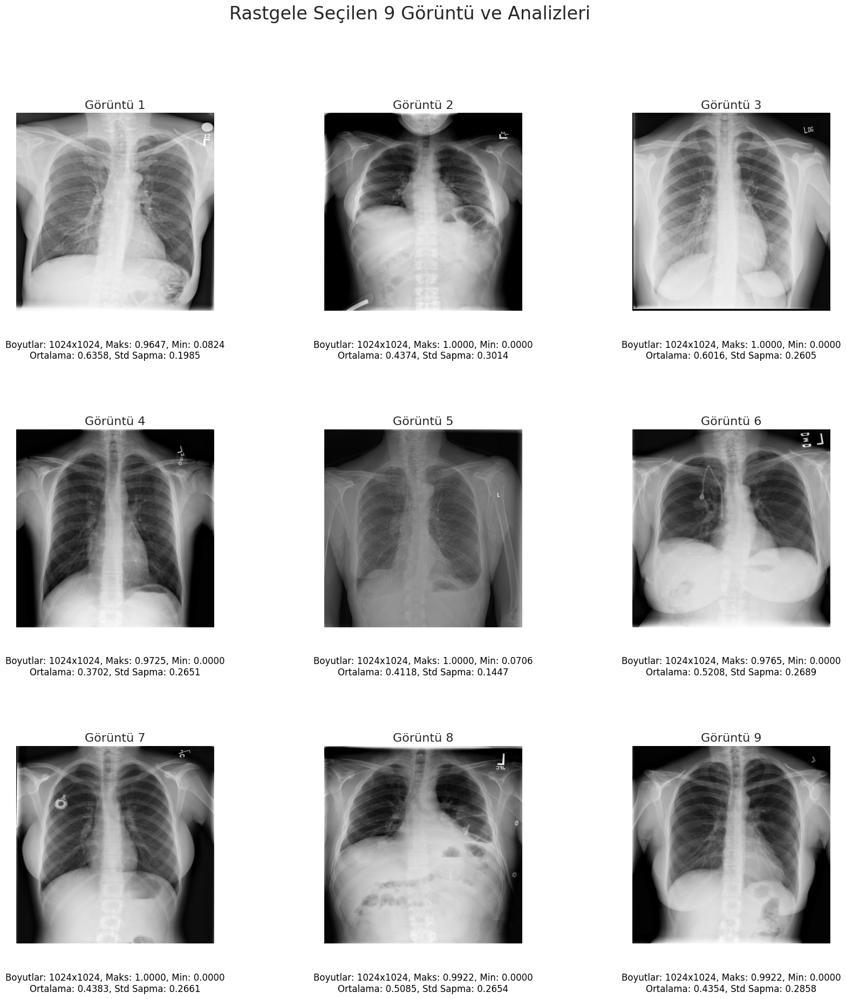

In [ ]:
# 9 rastgele görüntü için 3x3 görselleştirme düzeni
fig, axes = plt.subplots(3, 3, figsize=(20, 20))
fig.suptitle('Rastgele Seçilen 9 Görüntü ve Analizleri', fontsize=24)

# Görselleştirme ve analiz döngüsü
for idx, (ax, image_name) in enumerate(zip(axes.flatten(), random_images)):
    # Görüntü dosyasını yükleme
    img_path = os.path.join(img_dir, image_name)
    raw_image = plt.imread(img_path)

    # Görüntüyü gri tonlamada görselleştirme
    ax.imshow(raw_image, cmap='gray')
    ax.set_title(f'Görüntü {idx+1}', fontsize=16)
    ax.axis('off')  # Eksenleri kaldırma

    # Her görselin altına analiz sonuçlarını yazdırma
    ax.text(
        0.5, -0.2,
        f"Boyutlar: {raw_image.shape[0]}x{raw_image.shape[1]}, Maks: {raw_image.max():.4f}, Min: {raw_image.min():.4f}\n"
        f"Ortalama: {raw_image.mean():.4f}, Std Sapma: {raw_image.std():.4f}",
        fontsize=12, color='black', ha='center', va='center', transform=ax.transAxes
    )

# Genel boşluk ayarları
plt.subplots_adjust(wspace=0.4, hspace=0.6)
plt.show()


## 2.3 Histogram Çizimi
* Rastgele seçilen her bir görsel için piksel yoğunluk histogramları çizilmesi.

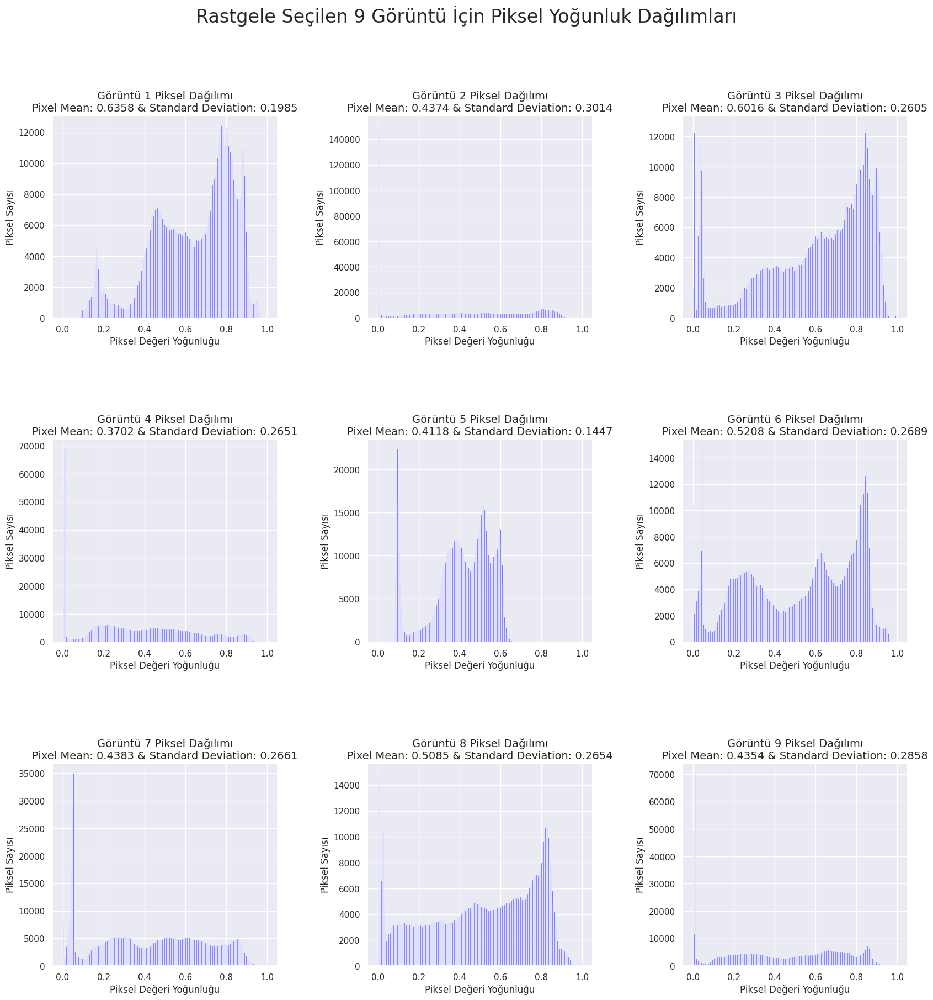

In [ ]:
# 9 rastgele görüntü için piksel yoğunluk histogramlarını oluşturma
fig, axes = plt.subplots(3, 3, figsize=(20, 20))
fig.suptitle('Rastgele Seçilen 9 Görüntü İçin Piksel Yoğunluk Dağılımları', fontsize=24)

# Görselleştirme döngüsü
for idx, (ax, image_name) in enumerate(zip(axes.flatten(), random_images)):
    # Görüntü dosyasını yükleme
    img_path = os.path.join(img_dir, image_name)
    raw_image = plt.imread(img_path)

    # Piksel yoğunluk histogramını oluşturma
    ax.hist(raw_image.ravel(), bins=256, range=[0, 1], color='blue', alpha=0.7)
    ax.set_title(f'Görüntü {idx+1} Piksel Dağılımı', fontsize=16)
    ax.set_xlabel('Piksel Değeri Yoğunluğu', fontsize=12)
    ax.set_ylabel('Piksel Sayısı', fontsize=12)

    # Piksel yoğunluklarına ilişkin ortalama ve standart sapmayı başlık altına ekleme
    pixel_mean = np.mean(raw_image)
    pixel_std = np.std(raw_image)
    ax.set_title(
        f'Görüntü {idx+1} Piksel Dağılımı\nPixel Mean: {pixel_mean:.4f} & Standard Deviation: {pixel_std:.4f}',
        fontsize=14
    )

# Genel düzenlemeler
plt.subplots_adjust(wspace=0.4, hspace=0.6)
plt.show()

# 3. Görüntü İşleme ve İyileştirme

## 3.1 Kontrast Germe
* Minimum ve maksimum piksel değerlerine göre kontrast germe işlemi yapılması


## 3.2 Histogram Eşitleme
* Kontrast germe sonrası histogram eşitleme uygulayarak kontrastın artırılması

## 3.3 Gamma Düzeltme
* Görüntünün parlaklığının gamma düzeltme yöntemi ile ayarlanması.

## 3.4 İşlemlerin tek adımda uygulanması ve karşılaştırılması

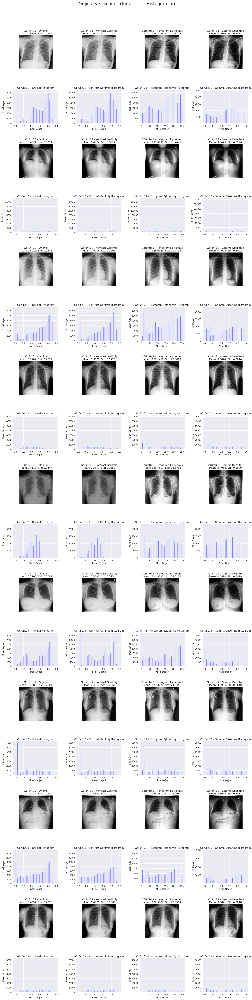

In [ ]:
# Fonksiyonlar
def stretch_contrast(image):
    min_val = image.min()
    max_val = image.max()
    return (image - min_val) / (max_val - min_val)

def equalize_histogram(image):
    normalized_img = cv2.normalize(image, None, 0, 255, cv2.NORM_MINMAX).astype('uint8')
    return cv2.equalizeHist(normalized_img)

def gamma_correction(image, gamma=1.5):
    normalized_img = image / image.max()
    return np.power(normalized_img, gamma)

# Görselleştirme döngüsü
fig, axes = plt.subplots(len(random_images) * 2, 4, figsize=(24, len(random_images) * 10))
fig.suptitle('Orijinal ve İşlenmiş Görseller ile Histogramları', fontsize=24)

# Genel başlık ile grafikler arasındaki boşluğu azaltma
plt.subplots_adjust(top=0.95, wspace=0.4, hspace=0.6)

for idx, image_name in enumerate(random_images):
    # Görüntü dosyasını yükleme
    img_path = os.path.join(img_dir, image_name)
    raw_image = plt.imread(img_path)

    # İşleme adımları
    stretched_image = stretch_contrast(raw_image)
    equalized_image = equalize_histogram(stretched_image)  # Kontrast gerilmiş görüntüde histogram eşitleme
    gamma_corrected_image = gamma_correction(equalized_image, gamma=1.5)  # Histogram eşitlenmiş görüntüde gamma düzeltme

    # Görselleri görselleştirme
    images = [raw_image, stretched_image, equalized_image, gamma_corrected_image]
    histograms = [img.ravel() for img in images]
    titles = ["Orijinal", "Kontrast Gerilmiş", "Histogram Eşitlenmiş", "Gamma Düzeltme"]

    for col, (img, hist, title) in enumerate(zip(images, histograms, titles)):
        # Görsel istatistikleri hesaplama
        mean_value = img.mean()
        std_value = img.std()

        # Görseller
        ax_img = axes[idx * 2, col]
        ax_img.imshow(img, cmap='gray')
        ax_img.set_title(f"Görüntü {idx+1} - {title}\nMean: {mean_value:.4f}, Std: {std_value:.4f}", fontsize=14)
        ax_img.axis('off')

        # Histogramlar
        ax_hist = axes[idx * 2 + 1, col]
        ax_hist.hist(hist, bins=256, range=[0, 1 if col != 2 else 255], color='blue', alpha=0.7)
        ax_hist.set_title(f"Görüntü {idx+1} - {title} Histogram", fontsize=14)
        ax_hist.set_xlabel('Piksel Değeri', fontsize=12)
        ax_hist.set_ylabel('Piksel Sayısı', fontsize=12)

# Grafiklerin gösterimi
plt.show()


## 4. Gürültü Azaltma

### 4.1 Median ve Gaussian Blur Uygulama
* Gamma düzeltme sonrası, median ve gaussian blur uygulanması ve sonuçları karşılaştırılması.

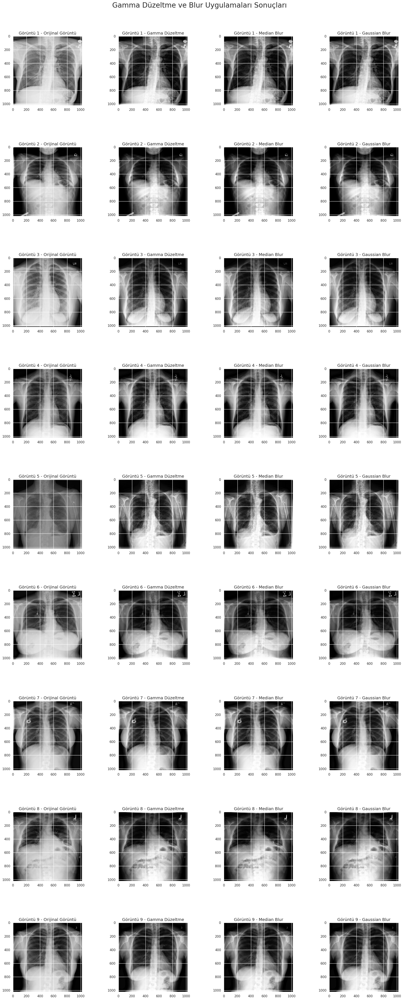

In [ ]:
# Median ve Gaussian Blur uygulama fonksiyonları
def apply_median_blur(image, kernel_size=5):
    return cv2.medianBlur((image * 255).astype('uint8'), kernel_size)

def apply_gaussian_blur(image, kernel_size=5, sigma=1):
    return cv2.GaussianBlur((image * 255).astype('uint8'), (kernel_size, kernel_size), sigma)

# Görselleştirme döngüsü
fig, axes = plt.subplots(len(random_images), 4, figsize=(24, len(random_images) * 6))
fig.suptitle('Gamma Düzeltme ve Blur Uygulamaları Sonuçları', fontsize=24)

# Genel başlık ile grafikler arasındaki boşluğu azaltma
plt.subplots_adjust(top=0.95, wspace=0.4, hspace=0.6)

for idx, image_name in enumerate(random_images):
    # Görüntü dosyasını yükleme
    img_path = os.path.join(img_dir, image_name)
    raw_image = plt.imread(img_path)

    # İşleme adımları
    stretched_image = stretch_contrast(raw_image)
    equalized_image = equalize_histogram(stretched_image)
    gamma_corrected_image = gamma_correction(equalized_image, gamma=1.5)

    # Blur işlemleri
    median_blurred_image = apply_median_blur(gamma_corrected_image)
    gaussian_blurred_image = apply_gaussian_blur(gamma_corrected_image)

    # Görselleri görselleştirme
    images = [raw_image, gamma_corrected_image, median_blurred_image, gaussian_blurred_image]
    titles = ["Orijinal Görüntü", "Gamma Düzeltme", "Median Blur", "Gaussian Blur"]

    for col, (img, title) in enumerate(zip(images, titles)):
        # Görseller
        ax_img = axes[idx, col]
        ax_img.imshow(img, cmap='gray')
        ax_img.set_title(f"Görüntü {idx+1} - {title}", fontsize=14)
        # ax_img.axis('off')

# Grafiklerin gösterimi
plt.show()


# 5. Döndürme ve Ayna Çevirme (Flipping)

## 5.1 Rastgele Açılarla Döndürme ve Ayna Çevirme
* Görüntülerin 0-10 derece arasında rastgele bir açıda döndürülmesi.
* Görüntünün yatay olarak çevrilmesi ve sonuçların görselleştirilmesi.

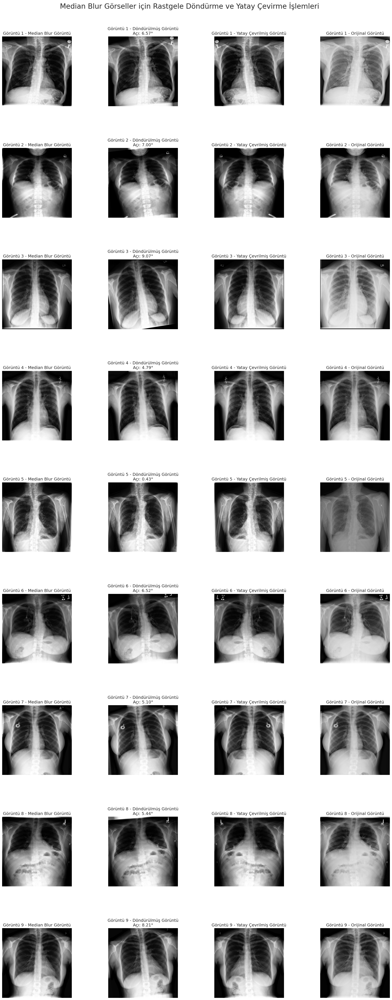

In [ ]:
# Görüntü döndürme fonksiyonu (rastgele açı)
def random_rotation(image, max_angle=10):
    angle = random.uniform(0, max_angle)
    return rotate(image, angle, mode='edge'), angle

# Görüntü ayna çevirme fonksiyonu (horizontal flipping)
def flip_image(image):
    return np.fliplr(image)

# Görselleştirme döngüsü
fig, axes = plt.subplots(len(random_images), 4, figsize=(24, len(random_images) * 6))
fig.suptitle('Median Blur Görseller için Rastgele Döndürme ve Yatay Çevirme İşlemleri', fontsize=24)

# Genel başlık ile grafikler arasındaki boşluğu azaltma
plt.subplots_adjust(top=0.95, wspace=0.4, hspace=0.6)

for idx, image_name in enumerate(random_images):
    # Görüntü dosyasını yükleme
    img_path = os.path.join(img_dir, image_name)
    raw_image = plt.imread(img_path)

    # İşleme adımları
    stretched_image = stretch_contrast(raw_image)
    equalized_image = equalize_histogram(stretched_image)
    gamma_corrected_image = gamma_correction(equalized_image, gamma=1.5)
    median_blurred = apply_median_blur(gamma_corrected_image)

    # Rastgele döndürme işlemi
    rotated_image, rotation_angle = random_rotation(median_blurred)

    # Yatay çevirme işlemi
    flipped_image = flip_image(median_blurred)

    # Görselleri görselleştirme
    images = [median_blurred, rotated_image, flipped_image, raw_image]
    titles = [
        "Median Blur Görüntü",
        f"Döndürülmüş Görüntü\nAçı: {rotation_angle:.2f}°",
        "Yatay Çevrilmiş Görüntü",
        "Orijinal Görüntü"
    ]

    for col, (img, title) in enumerate(zip(images, titles)):
        ax = axes[idx, col]
        ax.imshow(img, cmap='gray')
        ax.set_title(f"Görüntü {idx+1} - {title}", fontsize=14)
        ax.axis('off')

# Grafiklerin gösterimi
plt.show()


# 6. Frekans Alanında Filtreleme

## 6.1 Fourier Dönüşümü ve Frekans Filtreleme
* Görüntünün frekans alanına dönüştürülmesi, düşük frekansları geçiren bir maske uygulanması ve ardından ters Fourier dönüşümü ile frekans alanında filtreleme işleminin gerçekleştirilmesi.


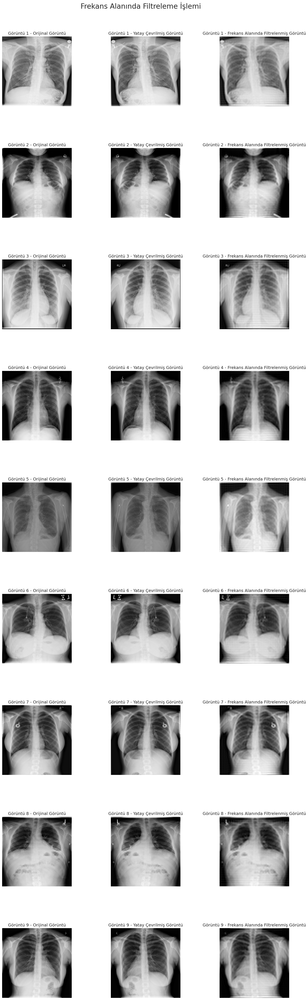

In [ ]:
# Fourier dönüşümü ve frekans alanında filtreleme fonksiyonu
def frequency_filter(image, filter_size=30):
    # Fourier dönüşümü ve frekansların merkeze kaydırılması
    dft = cv2.dft(np.float32(image), flags=cv2.DFT_COMPLEX_OUTPUT)
    dft_shifted = np.fft.fftshift(dft)

    # Maske oluşturma (düşük frekansları geçiren)
    rows, cols = image.shape
    crow, ccol = rows // 2, cols // 2
    mask = np.zeros((rows, cols, 2), np.uint8)
    mask[crow-filter_size:crow+filter_size, ccol-filter_size:ccol+filter_size] = 1

    # Maskeyi uygula ve ters Fourier dönüşümü yap
    fshift = dft_shifted * mask
    f_ishift = np.fft.ifftshift(fshift)
    filtered_image = cv2.idft(f_ishift)
    filtered_image = cv2.magnitude(filtered_image[:, :, 0], filtered_image[:, :, 1])

    # Görüntüyü normalize et
    filtered_image = cv2.normalize(filtered_image, None, 0, 255, cv2.NORM_MINMAX)
    return filtered_image

# Görselleştirme döngüsü
fig, axes = plt.subplots(len(random_images), 3, figsize=(18, len(random_images) * 6))
fig.suptitle('Frekans Alanında Filtreleme İşlemi', fontsize=24)

# Genel başlık ile grafikler arasındaki boşluğu azaltma
plt.subplots_adjust(top=0.95, wspace=0.4, hspace=0.6)

for idx, image_name in enumerate(random_images):
    # Görüntü dosyasını yükleme
    img_path = os.path.join(img_dir, image_name)
    raw_image = plt.imread(img_path)

    # Görüntüyü yatay çevirme
    flipped_image = flip_image(raw_image)

    # Frekans alanında filtreleme
    filtered_image = frequency_filter(flipped_image, filter_size=30)

    # Görselleştirme
    titles = ["Orijinal Görüntü", "Yatay Çevrilmiş Görüntü", "Frekans Alanında Filtrelenmiş Görüntü"]
    images = [raw_image, flipped_image, filtered_image]

    for col, (img, title) in enumerate(zip(images, titles)):
        ax = axes[idx, col]
        ax.imshow(img, cmap='gray')
        ax.set_title(f"Görüntü {idx+1} - {title}", fontsize=14)
        ax.axis('off')

# Grafiklerin gösterimi
plt.show()


# 7. Keskinleştirme ve Enterpolasyon

## 7.1 Görüntü Keskinleştirme ve Bicubic Enterpolasyon Uygulaması
* `Unsharp masking` tekniği kullanılarak görüntünün keskinleştirilmesi.
* Görüntünün iki kat büyütülerek bicubic enterpolasyon yöntemi ile yeniden boyutlandırılması.

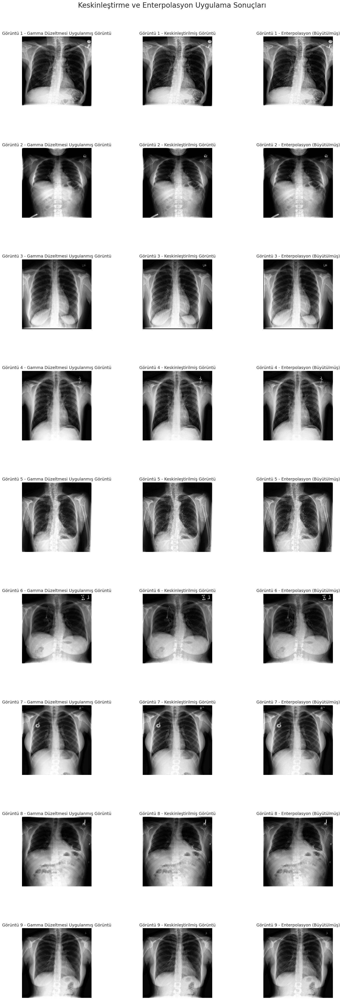

In [ ]:
# Keskinleştirme Fonksiyonu (Unsharp Masking)
def apply_unsharp_mask(image):
    sharpening_kernel = np.array([[-1, -1, -1],
                                   [-1,  9, -1],
                                   [-1, -1, -1]])
    sharpened = cv2.filter2D(image, -1, sharpening_kernel)
    return sharpened

# Bicubic Enterpolasyon Fonksiyonu
def apply_bicubic_interpolation(image, scale_factor=2):
    resized = zoom(image, scale_factor, order=3)  # Bicubic enterpolasyon (order=3)
    return resized

# Görselleştirme Döngüsü
fig, axes = plt.subplots(len(random_images), 3, figsize=(20, len(random_images) * 6))
fig.suptitle('Keskinleştirme ve Enterpolasyon Uygulama Sonuçları', fontsize=24)
plt.subplots_adjust(top=0.95, wspace=0.4, hspace=0.6)

for idx, image_name in enumerate(random_images):
    # Görüntü dosyasını yükleme
    img_path = os.path.join(img_dir, image_name)
    raw_image = plt.imread(img_path)

    # Gamma düzeltmesi uygulanmış görüntüyü oluşturma
    stretched_image = stretch_contrast(raw_image)
    equalized_image = equalize_histogram(stretched_image)
    gamma_corrected_image = gamma_correction(equalized_image, gamma=1.5)

    # Keskinleştirme işlemi
    sharpened_image = apply_unsharp_mask((gamma_corrected_image * 255).astype(np.uint8))

    # Enterpolasyon (Büyütme) işlemi
    interpolated_image = apply_bicubic_interpolation(sharpened_image, scale_factor=2)

    # Görselleştirme
    titles = ["Gamma Düzeltmesi Uygulanmış Görüntü", "Keskinleştirilmiş Görüntü", "Enterpolasyon (Büyütülmüş)"]
    images = [gamma_corrected_image, sharpened_image, interpolated_image]

    for col, (img, title) in enumerate(zip(images, titles)):
        ax = axes[idx, col]
        ax.imshow(img, cmap='gray')
        ax.set_title(f"Görüntü {idx+1} - {title}", fontsize=14)
        ax.axis('off')

# Görsellerin Gösterimi
plt.show()


In [ ]:
import os

# Çıkış dizinlerini tanımlama
output_dir = "output_images"
original_dir = os.path.join(output_dir, "original")
final_dir = os.path.join(output_dir, "final")

# Dizinleri oluşturma
os.makedirs(original_dir, exist_ok=True)
os.makedirs(final_dir, exist_ok=True)

# Fotoğrafları işleme ve kaydetme döngüsü
for idx, image_name in enumerate(random_images):
    # Görüntü dosyasını yükleme
    img_path = os.path.join(img_dir, image_name)
    raw_image = plt.imread(img_path)

    # Gamma düzeltmesi uygulanmış görüntüyü oluşturma
    stretched_image = stretch_contrast(raw_image)
    equalized_image = equalize_histogram(stretched_image)
    gamma_corrected_image = gamma_correction(equalized_image, gamma=1.5)

    # Keskinleştirme işlemi
    sharpened_image = apply_unsharp_mask((gamma_corrected_image * 255).astype(np.uint8))

    # Enterpolasyon (Büyütme) işlemi
    interpolated_image = apply_bicubic_interpolation(sharpened_image, scale_factor=2)

    # İlk görüntü (Gamma Düzeltmesi uygulanmış) kaydetme
    original_image_path = os.path.join(original_dir, f"image_{idx+1}_original.png")
    plt.imsave(original_image_path, raw_image, cmap='gray')

    # İlk görüntü (Gamma Düzeltmesi uygulanmış) kaydetme
    gamma_corrected_image_path = os.path.join(original_dir, f"image_{idx+1}_gamma_corrected.png")
    plt.imsave(gamma_corrected_image_path, gamma_corrected_image, cmap='gray')

    # Son görüntü (Keskinleştirilmiş ve Enterpolasyon uygulanmış) kaydetme
    final_image_path = os.path.join(final_dir, f"image_{idx+1}_final.png")
    plt.imsave(final_image_path, interpolated_image, cmap='gray')

print(f"Tüm görüntüler başarıyla '{output_dir}' dizinine kaydedildi!")


Tüm görüntüler başarıyla 'output_images' dizinine kaydedildi!


In [ ]:
import shutil

# Define the source and destination paths
folder_to_zip = '/content/AI-for-Medicine-Specialization/AI-for-Medical-Diagnosis/output_images'
output_zip_path = '/content/output_images.zip'

# Compress the folder
shutil.make_archive(output_zip_path.replace('.zip', ''), 'zip', folder_to_zip)


'/content/output_images.zip'

In [ ]:
from google.colab import files

# Download the ZIP file
files.download(output_zip_path)


<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>